In [27]:
import matplotlib.pyplot as plt
import tkinter as tk
from tkinter import filedialog
import numpy as np
import pandas as pd
from scipy import signal
import datetime

plt.close('all')
%matplotlib notebook

# Watch the video

In [28]:
import io
import base64
from IPython.display import HTML
video_path = r"C:\Users\marti\Google Drive\01_data_IMUandVIDEO\raw_noSync_noCalib\Team_NilsMartinTobi\Saturday_morning\3F7F\preprocessed\combinedVideo_104418_to_104636.mp4"
video = io.open(video_path, 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video width="700" controls>
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii')))

# Load Data

In [29]:
file_path = r"C:\Users\marti\Google Drive\01_data_IMUandVIDEO\raw_noSync_noCalib\Team_NilsMartinTobi\Saturday_morning\3F7F\preprocessed\NilsPodX-3F7F_20190406_1036_calib_sync.csv"
dataset = pd.read_csv(file_path)

# Create Time Axis

In [30]:
n = len(dataset["sample_ctr"])
sampling_rate = 204.8

today = datetime.datetime.now()
today_morning = datetime.datetime.strptime((today.strftime('%Y%m%d') + "000000"),"%Y%m%d%H%M%S")
session_start_time = datetime.datetime.strptime(dataset["time_received_debug"][0],"%H:%M:%S").time()
session_start_datetime = datetime.datetime.combine(today_morning.date(),session_start_time)
time_axis = [session_start_datetime+datetime.timedelta(milliseconds=idx*(1/sampling_rate)*1000) for idx,cnt in enumerate(dataset["sample_ctr"])]

# Filter Data

In [31]:
fc = 0.25  # Cut-off frequency of the filter
w = fc / (sampling_rate / 2) # Normalize the frequency
b, a = signal.butter(5, w, 'low')
acc_x_filtered = signal.filtfilt(b, a, dataset["acc_x"])
acc_y_filtered = signal.filtfilt(b, a, dataset["acc_y"])
acc_z_filtered = signal.filtfilt(b, a, dataset["acc_z"])
gyro_x_filtered = signal.filtfilt(b, a, dataset["gyro_x"])
gyro_y_filtered = signal.filtfilt(b, a, dataset["gyro_y"])
gyro_z_filtered = signal.filtfilt(b, a, dataset["gyro_z"])

acc_x_filtered = signal.savgol_filter(dataset["acc_x"],1201,3)
acc_x_rolling = pd.DataFrame(acc_x_filtered).rolling(2000).mean()
acc_x_sign = np.sign(acc_x_rolling)
acc_x_sign_filtered = pd.DataFrame(acc_x_sign).rolling(1000).median()

C:\Users\marti\Anaconda2\envs\py3\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in sign
  del sys.path[0]


# Plot Acc Data (see sync peaks)

<IPython.core.display.Javascript object>


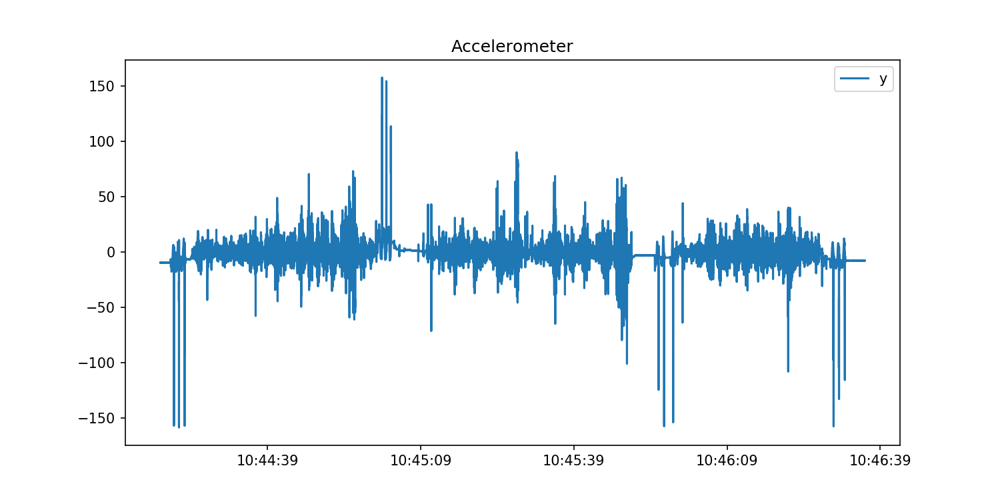

In [32]:
plt.figure(figsize=(10, 5));
#plt.plot(time_axis,dataset["acc_x"],label="x")
plt.plot(time_axis,dataset["acc_y"],label="y")
#plt.plot(time_axis,dataset["acc_z"],label="z")
plt.title('Accelerometer')
plt.legend();

# Direction Detector

<IPython.core.display.Javascript object>


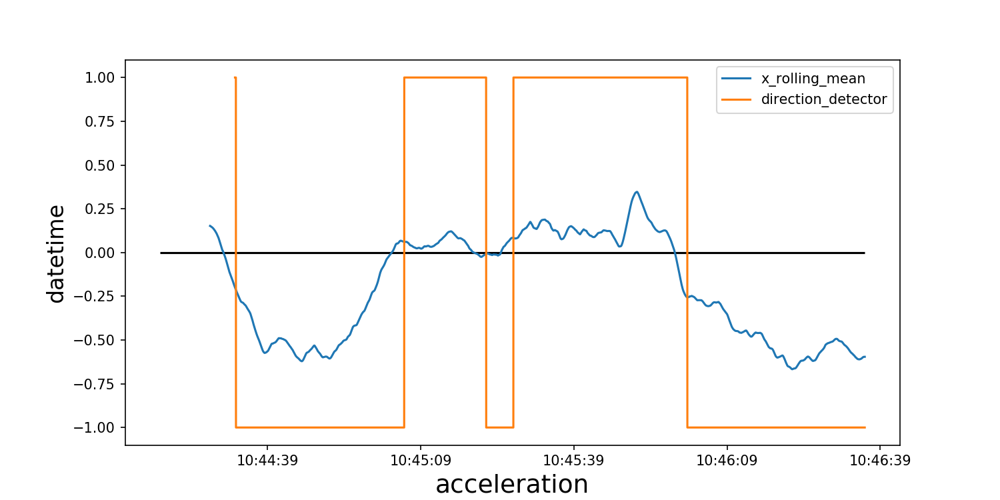

In [33]:
plt.figure(figsize=(10, 5))
#plt.plot(time_axis,dataset["acc_y"],label="x_filtered")
#plt.plot(time_axis,acc_x_filtered,label="x_filtered")
plt.plot(time_axis,acc_x_rolling,label="x_rolling_mean")
plt.plot(time_axis,acc_x_sign_filtered,label="direction_detector")
plt.hlines(0,time_axis[0],time_axis[-1])
plt.xlabel('acceleration', fontsize=18)
plt.ylabel('datetime', fontsize=16)
plt.legend(loc='upper right');

<IPython.core.display.Javascript object>


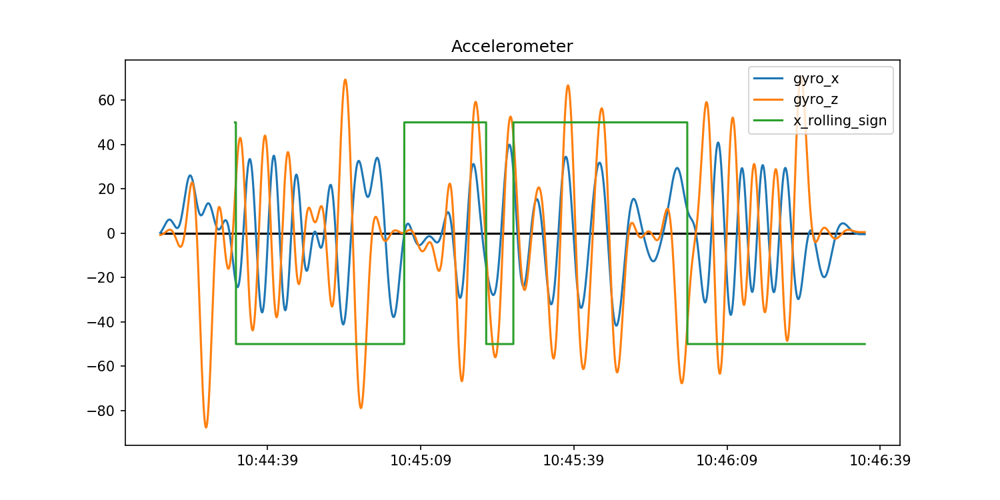

In [34]:
plt.figure(figsize=(10, 5));
plt.plot(time_axis,gyro_x_filtered,label="gyro_x")
plt.plot(time_axis,gyro_z_filtered,label="gyro_z")
plt.plot(time_axis,acc_x_sign_filtered*50,label="x_rolling_sign")
plt.hlines(0,time_axis[0],time_axis[-1])
plt.title('Accelerometer')
plt.legend(loc='upper right');

In [45]:
session_duration = np.size(acc_x_rolling)/sampling_rate
print(session_duration)

137.978515625


In [41]:
switch_duration = np.size((np.where(acc_x_sign_filtered == 1))[0])/sampling_rate
print(switch_duration)

50.2734375


In [42]:
straight_duration = np.size((np.where(acc_x_sign_filtered == -1))[0])/sampling_rate
print(straight_duration)

73.0419921875


In [43]:
switch_duration+straight_duration

123.3154296875